<a href="https://colab.research.google.com/github/zrghassabi/DeepLearning/blob/main/demo_03_TrainingDCGANSOnAnimeFacesData%5B1%5D.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## TODO Recording:

- Go to Drive
- Show the folder called anime_classification/
- Show the anime_images.zip file there

### Come to the notebook

- Show the runtime is GPU

In [ ]:
import os
import random
import torch
import torchvision
import torch.nn as nn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms

from tqdm import tqdm
from torchvision import transforms
from torchvision.utils import save_image, make_grid

import numpy as np
import matplotlib.pyplot as plt

Mounting the Google Drive

In [ ]:
from google.colab import drive

drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## TODO Recording

- After running the cell below please expand the left pane and show images/ folder
- Expand the images/ folder and show anime_images/
- Expand anime_images/ and show the contents of the folder
- There might be an extra __MACOS file

In [ ]:
!unzip '/content/drive/MyDrive/ai_workshop_dcgans/anime_classification/anime_images.zip' -d'/content/images'

Archive:  /content/drive/MyDrive/ai_workshop_dcgans/anime_classification/anime_images.zip
   creating: /content/images/anime_images/
  inflating: /content/images/__MACOSX/._anime_images  
  inflating: /content/images/anime_images/56274_2017.jpg  
  inflating: /content/images/__MACOSX/anime_images/._56274_2017.jpg  
  inflating: /content/images/anime_images/388_2000.jpg  
  inflating: /content/images/__MACOSX/anime_images/._388_2000.jpg  
  inflating: /content/images/anime_images/56275_2017.jpg  
  inflating: /content/images/__MACOSX/anime_images/._56275_2017.jpg  
  inflating: /content/images/anime_images/389_2000.jpg  
  inflating: /content/images/__MACOSX/anime_images/._389_2000.jpg  
  inflating: /content/images/anime_images/520_2000.jpg  
  inflating: /content/images/__MACOSX/anime_images/._520_2000.jpg  
  inflating: /content/images/anime_images/521_2000.jpg  
  inflating: /content/images/__MACOSX/anime_images/._521_2000.jpg  
  inflating: /content/images/anime_images/56188_2017.j

## TODO Recording

- Refresh the left pane and show the extra folder has disappeared
- Close the left pane

In [ ]:
!rm -rf '/content/images/__MACOSX'

Device is defined for Training


In [ ]:
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

 We will be using the ImageFolder dataset class, which requires there to be subdirectories in the dataset root folder. Now, we are creating  the dataset with applying transforms. Note that all images are resized to 64 (image_size=64). After  that Dataloader is created with batch size of 64.

In [ ]:
batch_size = 64
image_size = 64

# Create the dataset
anime_faces_dataset = dset.ImageFolder(root = '/content/images',
    transform = transforms.Compose([
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ]))

# Create the dataloader
train_dl = torch.utils.data.DataLoader(
    anime_faces_dataset,
    batch_size = batch_size,
    shuffle = True,
    num_workers = 2,
    drop_last = True
)

len(train_dl)

16

Plotting some training images

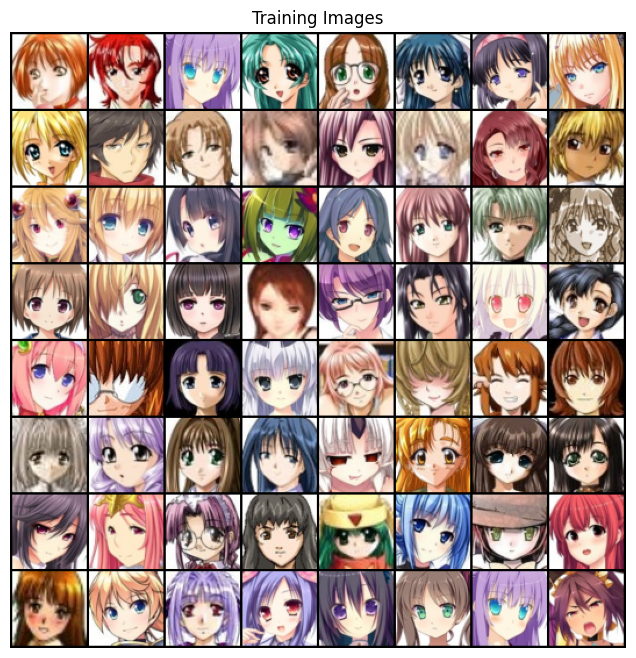

In [ ]:
real_batch = next(iter(train_dl))

plt.figure(figsize = (8 , 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(make_grid(real_batch[0].to(device), padding = 2, normalize = True).cpu(), (1, 2, 0)))

From the DCGAN paper, the authors specify that all model weights shall be randomly initialized from a Normal distribution with mean=0, stdev=0.02. The weights_init function takes an initialized model as input and reinitializes all convolutional, convolutional-transpose, and batch normalization layers to meet this criteria. This function is applied to the models immediately after initialization.

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__

    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 50

# Learning rate for optimizers
lr = 0.0002

# Number of GPUs
ngpu = 1

In [ ]:
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

device

device(type='cuda', index=0)

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.net = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(
                in_channels = nz,
                out_channels = ngf * 8,
                kernel_size = 4,
                stride = 1,
                padding = 0,
                bias = False
            ),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),

            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(
                in_channels = ngf * 8,
                out_channels = ngf * 4,
                kernel_size = 4,
                stride = 2, padding = 1,
                bias = False
            ),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),

            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d(
                in_channels = ngf * 4,
                out_channels = ngf * 2,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),

            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d(
                in_channels = ngf * 2,
                out_channels = ngf,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d(
                in_channels = ngf,
                out_channels = nc,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.Tanh()

            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, x):
        return self.net(x)

Generator is instantiated. Applying the 'weights_init' function to randomly initialize all weights like this: `to mean=0, stdev=0.2`. Generator Model architecture is printed

In [ ]:
netG = Generator().to(device)

netG.apply(weights_init)

print(netG)

Generator(
  (net): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.net = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(
                in_channels = nc,
                out_channels = ndf,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.LeakyReLU(0.2, inplace = True),

            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(
                in_channels = ndf,
                out_channels = ndf * 2,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace = True),

            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(
                in_channels = ndf * 2,
                out_channels = ndf * 4,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace = True),

            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(
                in_channels = ndf * 4,
                out_channels = ndf * 8,
                kernel_size = 4,
                stride = 2,
                padding = 1,
                bias = False
            ),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace = True),

            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(
                in_channels = ndf * 8,
                out_channels = 1,
                kernel_size = 4,
                stride = 1,
                padding = 0,
                bias = False
            ),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.net(x)

Discriminator is instantiated. Applying the 'weights_init' function to randomly initialize all weights like this: `to mean=0, stdev=0.2`. Discriminator Model architecture is printed

In [ ]:
netD = Discriminator().to(device)

netD.apply(weights_init)

print(netD)

Discriminator(
  (net): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [ ]:
z = torch.randn(64, 100, 1, 1, device = device)

# Generator network output
sample_gen_output = netG(z)

sample_gen_output

tensor([[[[-2.8156e-02,  3.1794e-02,  6.8847e-02,  ...,  7.5174e-02,
            4.5253e-02,  5.1653e-02],
          [ 2.7285e-02, -6.9271e-02,  8.2246e-02,  ...,  4.9781e-02,
            1.7333e-01, -3.7422e-02],
          [-1.3771e-02,  5.2663e-02, -2.6852e-02,  ...,  1.5143e-02,
            2.8183e-02,  8.5550e-02],
          ...,
          [ 7.3959e-02,  5.6344e-02,  1.1686e-01,  ..., -7.7204e-02,
            1.9746e-03, -9.3252e-02],
          [-2.9653e-02,  9.1487e-02,  8.5187e-02,  ...,  1.4443e-01,
            1.6597e-01,  3.5367e-02],
          [ 1.0731e-02, -2.0735e-02,  3.6307e-02,  ..., -8.2508e-02,
            6.5006e-02, -5.5059e-02]],

         [[ 4.9534e-02,  1.7552e-01,  5.8583e-02,  ...,  9.8881e-02,
            7.4182e-02,  2.9668e-02],
          [-5.1790e-02, -4.2172e-02, -6.5960e-02,  ..., -9.1541e-02,
           -9.9322e-02, -5.2746e-02],
          [ 7.6377e-02, -4.6916e-02,  2.9608e-01,  ...,  9.9185e-02,
            8.3568e-02,  3.9432e-02],
          ...,
     

In [ ]:
sample_gen_output.shape

torch.Size([64, 3, 64, 64])

Random generated output can be visualised individually or in batches

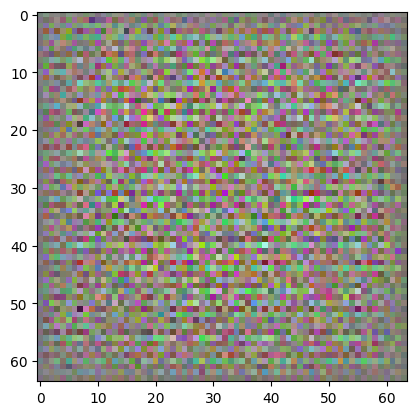

In [ ]:
plt.imshow(np.transpose(make_grid(sample_gen_output[0].to(device), padding = 2, normalize = True).cpu(),(1, 2, 0)))

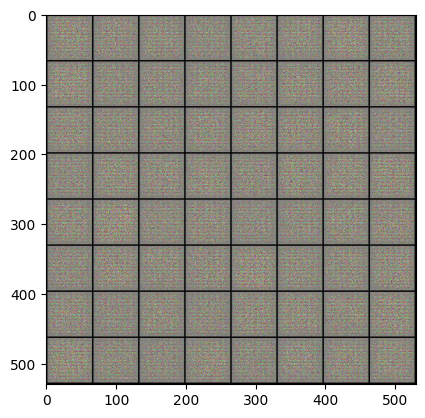

In [ ]:
 plt.imshow(np.transpose(make_grid(sample_gen_output.to(device), padding = 2, normalize = True).cpu(),(1, 2, 0)))

In [ ]:
netD.eval()

with torch.no_grad():
    prediction = netD(sample_gen_output)

print(prediction[:10])

tensor([[[[0.4961]]],


        [[[0.5024]]],


        [[[0.5001]]],


        [[[0.4999]]],


        [[[0.5014]]],


        [[[0.5014]]],


        [[[0.5007]]],


        [[[0.4982]]],


        [[[0.4971]]],


        [[[0.4999]]]], device='cuda:0')


https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html#loss-functions-and-optimizers
Loss functions and Optimizers are defined.Next, we define our real label as 1 and the fake label as 0. These labels will be used when calculating the losses of D and G, and this is also the convention used in the original GAN paper. Finally, we set up two separate optimizers, one for D and one for G. As specified in the DCGAN paper, both are Adam optimizers with learning rate 0.0002 and Beta1 = 0.5. For keeping track of the generator’s learning progression, we will generate a fixed batch of latent vectors that are drawn from a Gaussian distribution (i.e. fixed_noise) . In the training loop, we will periodically input this fixed_noise into G, and over the iterations we will see images form out of the noise.


In [ ]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device = device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr = lr, betas = (0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr = lr, betas = (0.5, 0.999))

In [ ]:
def display_image_grid(epoch: int, step: int,  images: torch.Tensor, nrow: int):
    images = images / 2 + 0.5
    image_grid = make_grid(images, nrow)     # Images in a grid
    image_grid = image_grid.permute(1, 2, 0) # Move channel last
    image_grid = image_grid.cpu().numpy()    # To Numpy

    plt.imshow(image_grid)
    plt.xticks([])
    plt.yticks([])
    plt.show()
    plt.close()

https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html#training
Finally, now that we have all of the parts of the GAN framework defined, we can train it. Be mindful that training GANs is somewhat of an art form, as incorrect hyperparameter settings lead to mode collapse with little explanation of what went wrong. Here, we will closely follow Algorithm 1 from the Goodfellow’s paper, while abiding by some of the best practices shown in ganhacks. Namely, we will “construct different mini-batches for real and fake” images, and also adjust G’s objective function to maximize
log(D(G(z))). Training is split up into two main parts. Part 1 updates the Discriminator and Part 2 updates the Generator.

Part 1 - Train the Discriminator

Recall, the goal of training the discriminator is to maximize the probability of correctly classifying a given input as real or fake. In terms of Goodfellow, we wish to “update the discriminator by ascending its stochastic gradient”. Practically, we want to maximize
log(D(x))+log(1−D(G(z))). Due to the separate mini-batch suggestion from ganhacks, we will calculate this in two steps. First, we will construct a batch of real samples from the training set, forward pass through
D, calculate the loss
log(D(x))), then calculate the gradients in a backward pass. Secondly, we will construct a batch of fake samples with the current generator, forward pass this batch through D, calculate the loss (

log(1−D(G(z)))), and accumulate the gradients with a backward pass. Now, with the gradients accumulated from both the all-real and all-fake batches, we call a step of the Discriminator’s optimizer.

Part 2 - Train the Generator

As stated in the original paper, we want to train the Generator by minimizing log(1−D(G(z))) in an effort to generate better fakes. As mentioned, this was shown by Goodfellow to not provide sufficient gradients, especially early in the learning process. As a fix, we instead wish to maximize log(D(G(z))). In the code we accomplish this by: classifying the Generator output from Part 1 with the Discriminator, computing G’s loss using real labels as GT, computing G’s gradients in a backward pass, and finally updating G’s parameters with an optimizer step. It may seem counter-intuitive to use the real labels as GT labels for the loss function, but this allows us to use the
log(x) part of the BCELoss (rather than the
log(1−x) part) which is exactly what we want.

Finally, we will do some statistic reporting and at the end of each epoch we will push our fixed_noise batch through the generator to visually track the progress of G’s training. The training statistics reported are:

Loss_D - discriminator loss calculated as the sum of losses for the all real and all fake batches
log(D(x))+log(1−D(G(z)))).

Loss_G - generator loss calculated as log(D(G(z)))

D(x) - the average output (across the batch) of the discriminator for the all real batch. This should start close to 1 then theoretically converge to 0.5 when G gets better. Think about why this is.

D(G(z)) - average discriminator outputs for the all fake batch. The first number is before D is updated and the second number is after D is updated. These numbers should start near 0 and converge to 0.5 as G gets better. Think about why this is.

Note: This step might take a while, depending on how many epochs you run and if you removed some data from the dataset.

## TODO Recording:

- Once you execute the cell below
- Scroll in the output slowly and show the changes in the image generated

  0%|          | 0/50 [00:00<?, ?it/s]

Epoch 0: |
                      Step: 0 | 
                      D_real Loss: 0.565 | 
                      D_fake Loss: 0.717 | 
                      D_total Loss: 1.282 | 
                      G_Loss: 0.675 |
                      Real_score 0.569 | 
                      Fake_score 0.512 |
                      Fake_score_after_D_update: 0.509
            


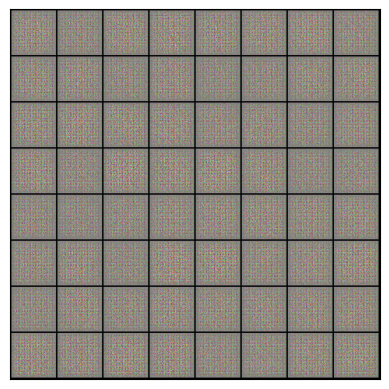

  2%|▏         | 1/50 [00:01<01:28,  1.81s/it]

Epoch 1: |
                      Step: 0 | 
                      D_real Loss: 0.003 | 
                      D_fake Loss: 0.320 | 
                      D_total Loss: 0.323 | 
                      G_Loss: 2.273 |
                      Real_score 0.997 | 
                      Fake_score 0.274 |
                      Fake_score_after_D_update: 0.104
            


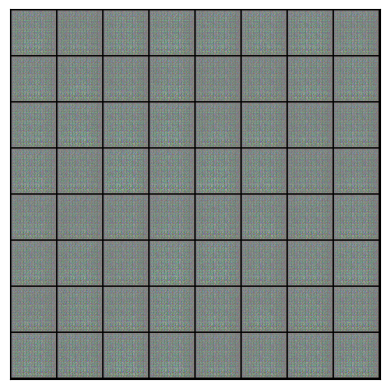

  4%|▍         | 2/50 [00:03<01:21,  1.70s/it]

Epoch 2: |
                      Step: 0 | 
                      D_real Loss: 0.002 | 
                      D_fake Loss: 0.663 | 
                      D_total Loss: 0.665 | 
                      G_Loss: 2.055 |
                      Real_score 0.998 | 
                      Fake_score 0.462 |
                      Fake_score_after_D_update: 0.141
            


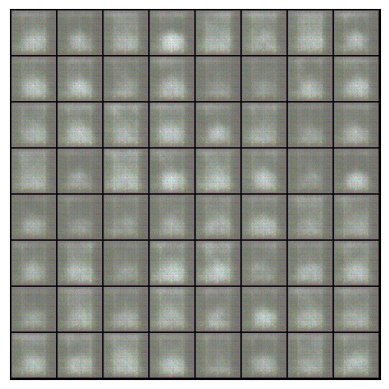

  6%|▌         | 3/50 [00:05<01:18,  1.67s/it]

Epoch 3: |
                      Step: 0 | 
                      D_real Loss: 0.139 | 
                      D_fake Loss: 0.565 | 
                      D_total Loss: 0.704 | 
                      G_Loss: 2.303 |
                      Real_score 0.887 | 
                      Fake_score 0.416 |
                      Fake_score_after_D_update: 0.117
            


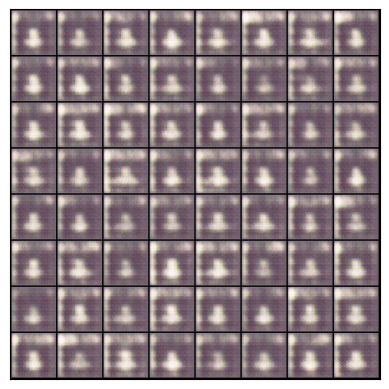

  8%|▊         | 4/50 [00:06<01:16,  1.65s/it]

Epoch 4: |
                      Step: 0 | 
                      D_real Loss: 0.255 | 
                      D_fake Loss: 0.586 | 
                      D_total Loss: 0.841 | 
                      G_Loss: 2.644 |
                      Real_score 0.813 | 
                      Fake_score 0.417 |
                      Fake_score_after_D_update: 0.089
            


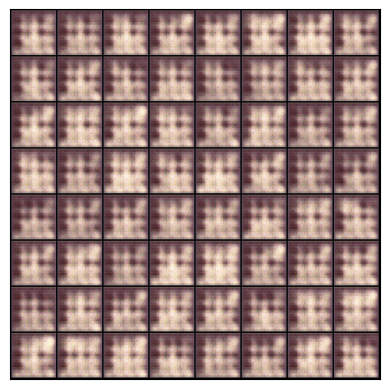

 10%|█         | 5/50 [00:08<01:13,  1.64s/it]

Epoch 5: |
                      Step: 0 | 
                      D_real Loss: 0.066 | 
                      D_fake Loss: 1.218 | 
                      D_total Loss: 1.285 | 
                      G_Loss: 3.345 |
                      Real_score 0.940 | 
                      Fake_score 0.687 |
                      Fake_score_after_D_update: 0.038
            


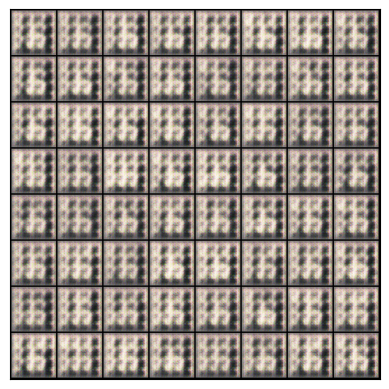

 12%|█▏        | 6/50 [00:09<01:12,  1.65s/it]

Epoch 6: |
                      Step: 0 | 
                      D_real Loss: 0.384 | 
                      D_fake Loss: 0.135 | 
                      D_total Loss: 0.519 | 
                      G_Loss: 2.602 |
                      Real_score 0.735 | 
                      Fake_score 0.125 |
                      Fake_score_after_D_update: 0.081
            


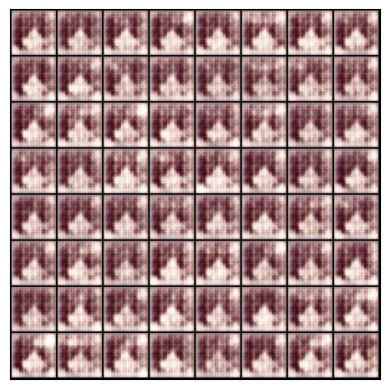

 14%|█▍        | 7/50 [00:12<01:18,  1.83s/it]

Epoch 7: |
                      Step: 0 | 
                      D_real Loss: 0.225 | 
                      D_fake Loss: 0.297 | 
                      D_total Loss: 0.522 | 
                      G_Loss: 4.101 |
                      Real_score 0.837 | 
                      Fake_score 0.247 |
                      Fake_score_after_D_update: 0.019
            


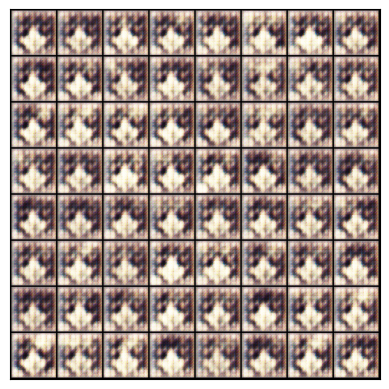

 16%|█▌        | 8/50 [00:14<01:20,  1.90s/it]

Epoch 8: |
                      Step: 0 | 
                      D_real Loss: 0.493 | 
                      D_fake Loss: 0.322 | 
                      D_total Loss: 0.814 | 
                      G_Loss: 1.896 |
                      Real_score 0.682 | 
                      Fake_score 0.274 |
                      Fake_score_after_D_update: 0.154
            


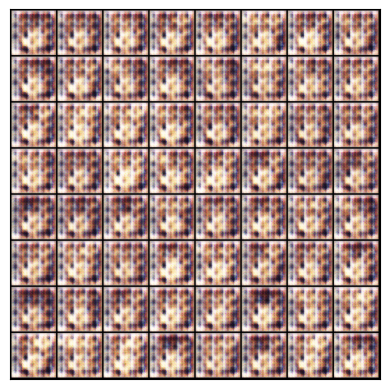

 18%|█▊        | 9/50 [00:15<01:15,  1.83s/it]

Epoch 9: |
                      Step: 0 | 
                      D_real Loss: 0.648 | 
                      D_fake Loss: 0.857 | 
                      D_total Loss: 1.505 | 
                      G_Loss: 1.250 |
                      Real_score 0.590 | 
                      Fake_score 0.570 |
                      Fake_score_after_D_update: 0.291
            


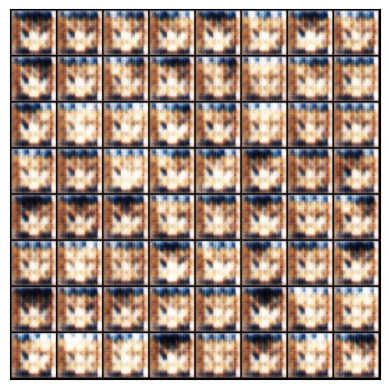

 20%|██        | 10/50 [00:17<01:11,  1.78s/it]

Epoch 10: |
                      Step: 0 | 
                      D_real Loss: 0.519 | 
                      D_fake Loss: 0.502 | 
                      D_total Loss: 1.021 | 
                      G_Loss: 1.696 |
                      Real_score 0.627 | 
                      Fake_score 0.393 |
                      Fake_score_after_D_update: 0.187
            


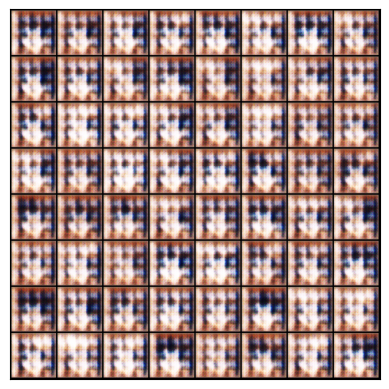

 22%|██▏       | 11/50 [00:19<01:08,  1.76s/it]

Epoch 11: |
                      Step: 0 | 
                      D_real Loss: 0.536 | 
                      D_fake Loss: 0.584 | 
                      D_total Loss: 1.120 | 
                      G_Loss: 1.955 |
                      Real_score 0.640 | 
                      Fake_score 0.430 |
                      Fake_score_after_D_update: 0.148
            


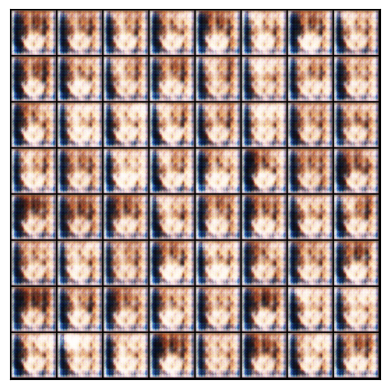

 24%|██▍       | 12/50 [00:20<01:05,  1.74s/it]

Epoch 12: |
                      Step: 0 | 
                      D_real Loss: 0.590 | 
                      D_fake Loss: 0.460 | 
                      D_total Loss: 1.050 | 
                      G_Loss: 1.542 |
                      Real_score 0.600 | 
                      Fake_score 0.363 |
                      Fake_score_after_D_update: 0.223
            


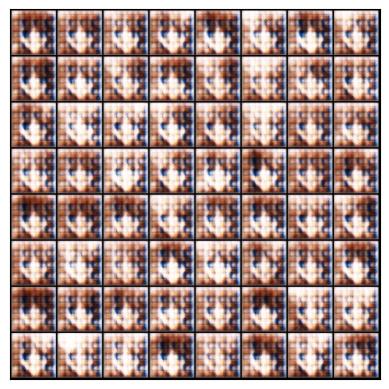

 26%|██▌       | 13/50 [00:22<01:04,  1.74s/it]

Epoch 13: |
                      Step: 0 | 
                      D_real Loss: 0.605 | 
                      D_fake Loss: 0.899 | 
                      D_total Loss: 1.505 | 
                      G_Loss: 1.881 |
                      Real_score 0.597 | 
                      Fake_score 0.572 |
                      Fake_score_after_D_update: 0.169
            


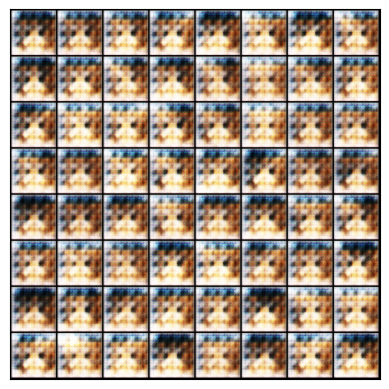

 28%|██▊       | 14/50 [00:24<01:02,  1.74s/it]

Epoch 14: |
                      Step: 0 | 
                      D_real Loss: 0.440 | 
                      D_fake Loss: 0.360 | 
                      D_total Loss: 0.800 | 
                      G_Loss: 1.916 |
                      Real_score 0.681 | 
                      Fake_score 0.298 |
                      Fake_score_after_D_update: 0.154
            


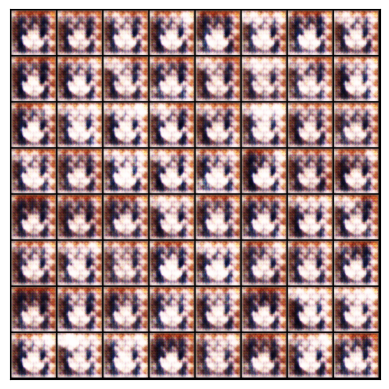

 30%|███       | 15/50 [00:27<01:14,  2.13s/it]

Epoch 15: |
                      Step: 0 | 
                      D_real Loss: 0.591 | 
                      D_fake Loss: 0.625 | 
                      D_total Loss: 1.216 | 
                      G_Loss: 1.824 |
                      Real_score 0.620 | 
                      Fake_score 0.451 |
                      Fake_score_after_D_update: 0.176
            


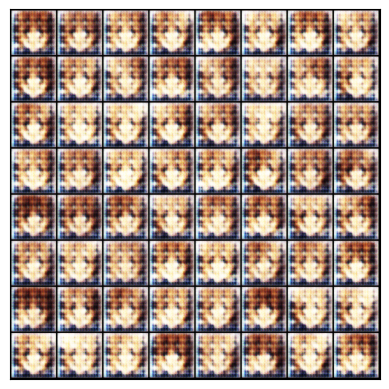

 32%|███▏      | 16/50 [00:29<01:13,  2.15s/it]

Epoch 16: |
                      Step: 0 | 
                      D_real Loss: 0.493 | 
                      D_fake Loss: 0.581 | 
                      D_total Loss: 1.074 | 
                      G_Loss: 1.876 |
                      Real_score 0.651 | 
                      Fake_score 0.432 |
                      Fake_score_after_D_update: 0.157
            


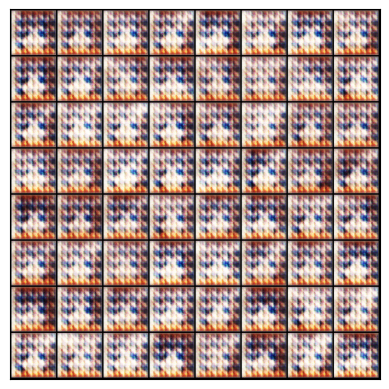

 34%|███▍      | 17/50 [00:31<01:07,  2.06s/it]

Epoch 17: |
                      Step: 0 | 
                      D_real Loss: 0.798 | 
                      D_fake Loss: 0.496 | 
                      D_total Loss: 1.294 | 
                      G_Loss: 1.782 |
                      Real_score 0.510 | 
                      Fake_score 0.383 |
                      Fake_score_after_D_update: 0.173
            


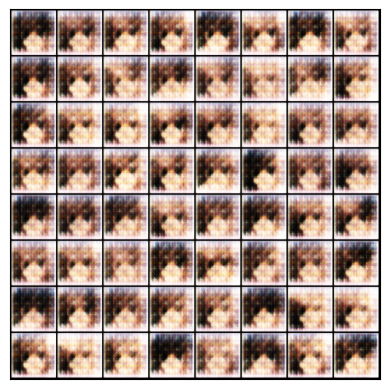

 36%|███▌      | 18/50 [00:33<01:03,  1.97s/it]

Epoch 18: |
                      Step: 0 | 
                      D_real Loss: 0.546 | 
                      D_fake Loss: 0.558 | 
                      D_total Loss: 1.104 | 
                      G_Loss: 1.867 |
                      Real_score 0.613 | 
                      Fake_score 0.425 |
                      Fake_score_after_D_update: 0.158
            


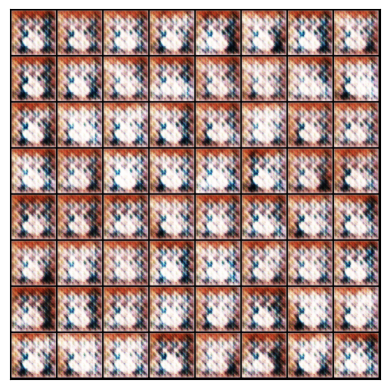

 38%|███▊      | 19/50 [00:35<00:58,  1.90s/it]

Epoch 19: |
                      Step: 0 | 
                      D_real Loss: 0.338 | 
                      D_fake Loss: 0.436 | 
                      D_total Loss: 0.774 | 
                      G_Loss: 2.209 |
                      Real_score 0.752 | 
                      Fake_score 0.340 |
                      Fake_score_after_D_update: 0.116
            


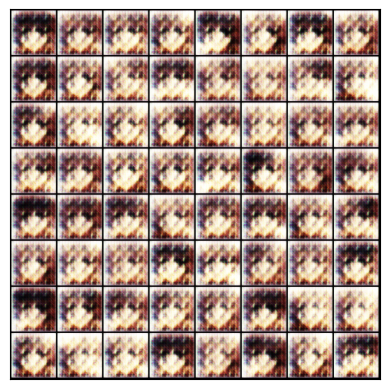

 40%|████      | 20/50 [00:47<02:29,  4.98s/it]

Epoch 20: |
                      Step: 0 | 
                      D_real Loss: 0.572 | 
                      D_fake Loss: 0.527 | 
                      D_total Loss: 1.099 | 
                      G_Loss: 1.821 |
                      Real_score 0.621 | 
                      Fake_score 0.403 |
                      Fake_score_after_D_update: 0.167
            


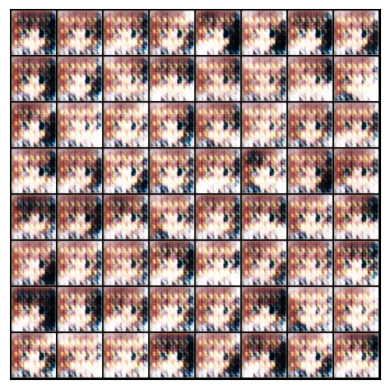

 42%|████▏     | 21/50 [00:49<01:57,  4.07s/it]

Epoch 21: |
                      Step: 0 | 
                      D_real Loss: 0.433 | 
                      D_fake Loss: 0.427 | 
                      D_total Loss: 0.860 | 
                      G_Loss: 1.605 |
                      Real_score 0.691 | 
                      Fake_score 0.343 |
                      Fake_score_after_D_update: 0.210
            


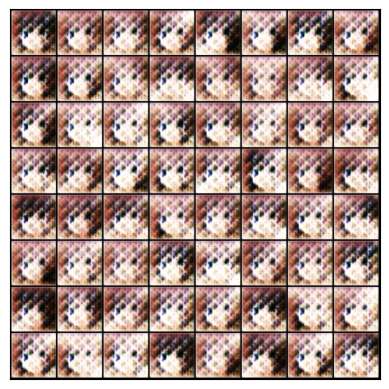

 44%|████▍     | 22/50 [00:51<01:36,  3.43s/it]

Epoch 22: |
                      Step: 0 | 
                      D_real Loss: 0.438 | 
                      D_fake Loss: 0.441 | 
                      D_total Loss: 0.879 | 
                      G_Loss: 1.603 |
                      Real_score 0.671 | 
                      Fake_score 0.355 |
                      Fake_score_after_D_update: 0.206
            


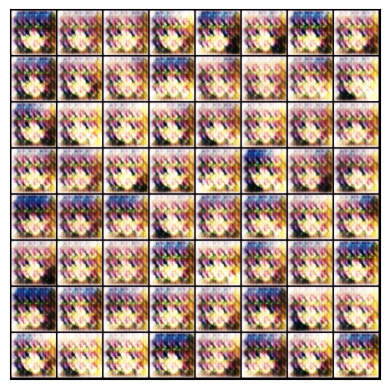

 46%|████▌     | 23/50 [00:53<01:23,  3.08s/it]

Epoch 23: |
                      Step: 0 | 
                      D_real Loss: 0.689 | 
                      D_fake Loss: 0.346 | 
                      D_total Loss: 1.035 | 
                      G_Loss: 1.316 |
                      Real_score 0.560 | 
                      Fake_score 0.290 |
                      Fake_score_after_D_update: 0.272
            


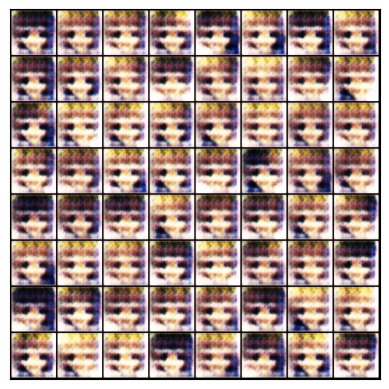

 48%|████▊     | 24/50 [00:56<01:17,  2.98s/it]

Epoch 24: |
                      Step: 0 | 
                      D_real Loss: 0.552 | 
                      D_fake Loss: 0.499 | 
                      D_total Loss: 1.052 | 
                      G_Loss: 1.613 |
                      Real_score 0.635 | 
                      Fake_score 0.391 |
                      Fake_score_after_D_update: 0.210
            


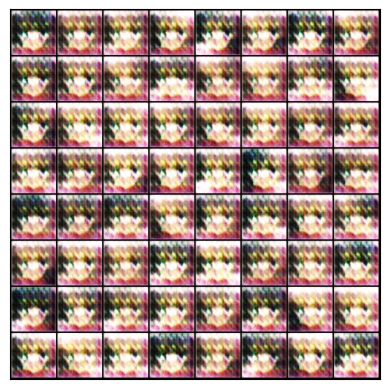

 50%|█████     | 25/50 [00:58<01:10,  2.81s/it]

Epoch 25: |
                      Step: 0 | 
                      D_real Loss: 0.463 | 
                      D_fake Loss: 0.325 | 
                      D_total Loss: 0.788 | 
                      G_Loss: 1.790 |
                      Real_score 0.661 | 
                      Fake_score 0.277 |
                      Fake_score_after_D_update: 0.168
            


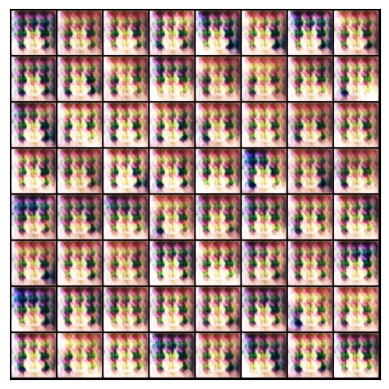

 52%|█████▏    | 26/50 [01:00<01:04,  2.69s/it]

Epoch 26: |
                      Step: 0 | 
                      D_real Loss: 0.756 | 
                      D_fake Loss: 0.387 | 
                      D_total Loss: 1.143 | 
                      G_Loss: 1.280 |
                      Real_score 0.543 | 
                      Fake_score 0.309 |
                      Fake_score_after_D_update: 0.292
            


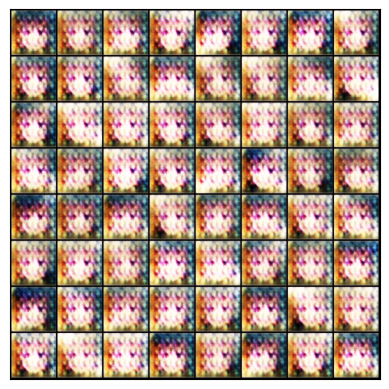

 54%|█████▍    | 27/50 [01:03<01:01,  2.66s/it]

Epoch 27: |
                      Step: 0 | 
                      D_real Loss: 0.344 | 
                      D_fake Loss: 0.686 | 
                      D_total Loss: 1.030 | 
                      G_Loss: 1.830 |
                      Real_score 0.743 | 
                      Fake_score 0.485 |
                      Fake_score_after_D_update: 0.170
            


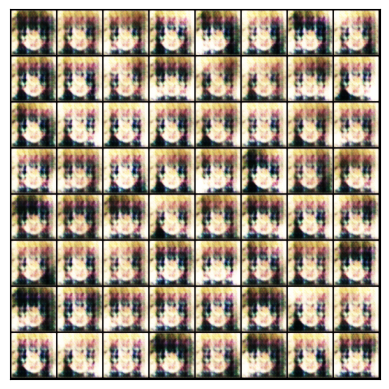

 56%|█████▌    | 28/50 [01:05<00:55,  2.53s/it]

Epoch 28: |
                      Step: 0 | 
                      D_real Loss: 0.587 | 
                      D_fake Loss: 0.492 | 
                      D_total Loss: 1.080 | 
                      G_Loss: 1.126 |
                      Real_score 0.591 | 
                      Fake_score 0.384 |
                      Fake_score_after_D_update: 0.330
            


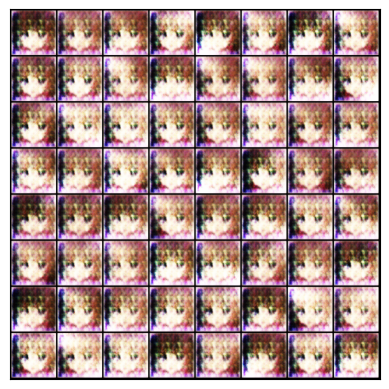

 58%|█████▊    | 29/50 [01:07<00:50,  2.38s/it]

Epoch 29: |
                      Step: 0 | 
                      D_real Loss: 0.495 | 
                      D_fake Loss: 0.418 | 
                      D_total Loss: 0.913 | 
                      G_Loss: 1.919 |
                      Real_score 0.667 | 
                      Fake_score 0.338 |
                      Fake_score_after_D_update: 0.162
            


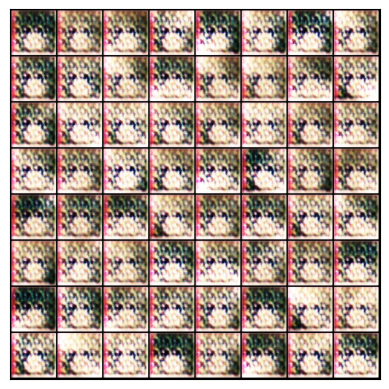

 60%|██████    | 30/50 [01:10<00:47,  2.39s/it]

Epoch 30: |
                      Step: 0 | 
                      D_real Loss: 0.416 | 
                      D_fake Loss: 1.047 | 
                      D_total Loss: 1.463 | 
                      G_Loss: 2.623 |
                      Real_score 0.697 | 
                      Fake_score 0.624 |
                      Fake_score_after_D_update: 0.085
            


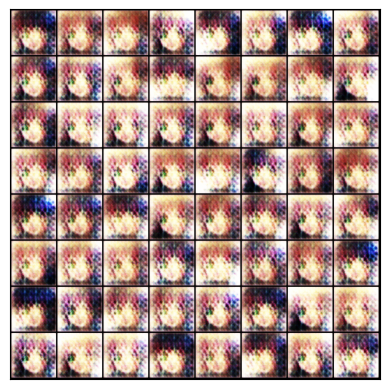

 62%|██████▏   | 31/50 [01:12<00:46,  2.43s/it]

Epoch 31: |
                      Step: 0 | 
                      D_real Loss: 0.676 | 
                      D_fake Loss: 0.441 | 
                      D_total Loss: 1.116 | 
                      G_Loss: 1.317 |
                      Real_score 0.540 | 
                      Fake_score 0.350 |
                      Fake_score_after_D_update: 0.276
            


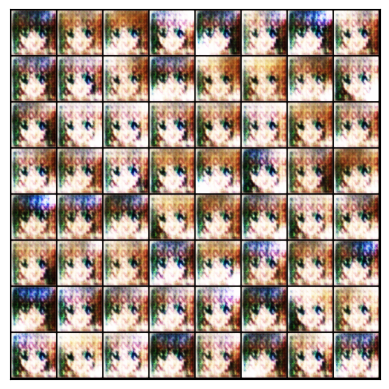

 64%|██████▍   | 32/50 [01:14<00:42,  2.35s/it]

Epoch 32: |
                      Step: 0 | 
                      D_real Loss: 0.601 | 
                      D_fake Loss: 0.401 | 
                      D_total Loss: 1.001 | 
                      G_Loss: 1.307 |
                      Real_score 0.583 | 
                      Fake_score 0.326 |
                      Fake_score_after_D_update: 0.278
            


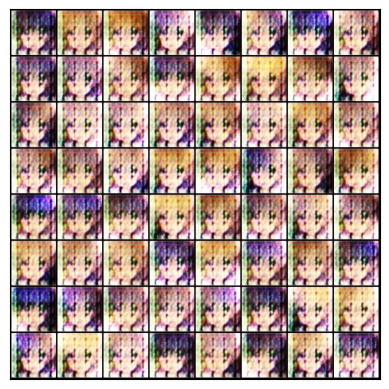

 66%|██████▌   | 33/50 [01:16<00:37,  2.21s/it]

Epoch 33: |
                      Step: 0 | 
                      D_real Loss: 0.505 | 
                      D_fake Loss: 0.549 | 
                      D_total Loss: 1.054 | 
                      G_Loss: 1.490 |
                      Real_score 0.629 | 
                      Fake_score 0.420 |
                      Fake_score_after_D_update: 0.228
            


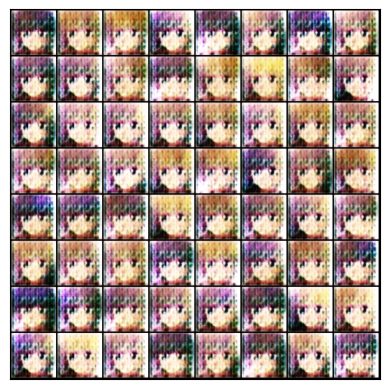

 68%|██████▊   | 34/50 [01:18<00:33,  2.11s/it]

Epoch 34: |
                      Step: 0 | 
                      D_real Loss: 0.572 | 
                      D_fake Loss: 0.628 | 
                      D_total Loss: 1.201 | 
                      G_Loss: 1.101 |
                      Real_score 0.590 | 
                      Fake_score 0.458 |
                      Fake_score_after_D_update: 0.339
            


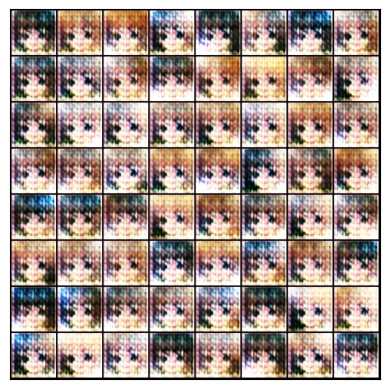

 70%|███████   | 35/50 [01:20<00:30,  2.02s/it]

Epoch 35: |
                      Step: 0 | 
                      D_real Loss: 0.717 | 
                      D_fake Loss: 0.522 | 
                      D_total Loss: 1.239 | 
                      G_Loss: 1.142 |
                      Real_score 0.514 | 
                      Fake_score 0.400 |
                      Fake_score_after_D_update: 0.327
            


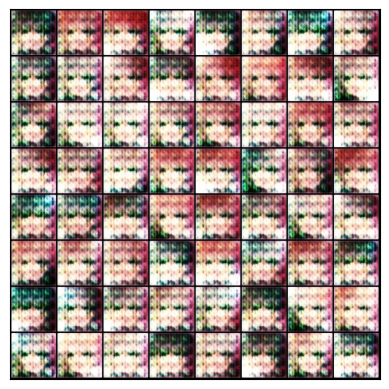

 72%|███████▏  | 36/50 [01:22<00:27,  1.97s/it]

Epoch 36: |
                      Step: 0 | 
                      D_real Loss: 0.521 | 
                      D_fake Loss: 0.416 | 
                      D_total Loss: 0.937 | 
                      G_Loss: 1.443 |
                      Real_score 0.614 | 
                      Fake_score 0.338 |
                      Fake_score_after_D_update: 0.240
            


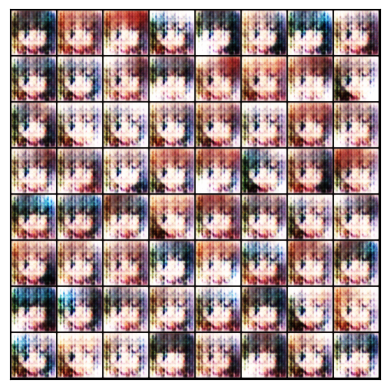

 74%|███████▍  | 37/50 [01:24<00:25,  1.98s/it]

Epoch 37: |
                      Step: 0 | 
                      D_real Loss: 0.698 | 
                      D_fake Loss: 0.410 | 
                      D_total Loss: 1.108 | 
                      G_Loss: 1.461 |
                      Real_score 0.549 | 
                      Fake_score 0.326 |
                      Fake_score_after_D_update: 0.236
            


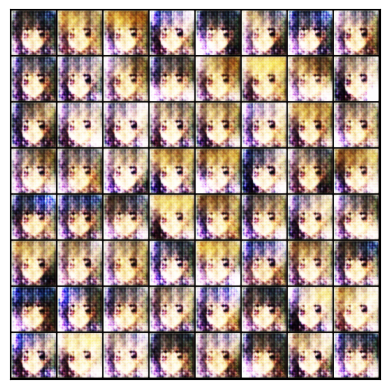

 76%|███████▌  | 38/50 [01:26<00:24,  2.08s/it]

Epoch 38: |
                      Step: 0 | 
                      D_real Loss: 0.349 | 
                      D_fake Loss: 0.511 | 
                      D_total Loss: 0.860 | 
                      G_Loss: 2.139 |
                      Real_score 0.724 | 
                      Fake_score 0.396 |
                      Fake_score_after_D_update: 0.125
            


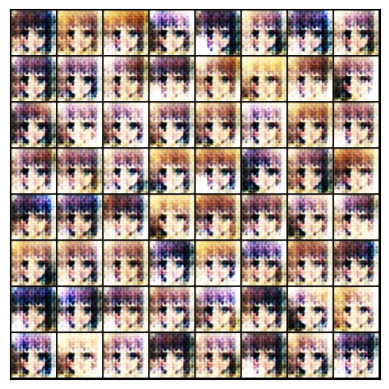

 78%|███████▊  | 39/50 [01:28<00:23,  2.12s/it]

Epoch 39: |
                      Step: 0 | 
                      D_real Loss: 0.528 | 
                      D_fake Loss: 0.528 | 
                      D_total Loss: 1.056 | 
                      G_Loss: 1.351 |
                      Real_score 0.616 | 
                      Fake_score 0.401 |
                      Fake_score_after_D_update: 0.271
            


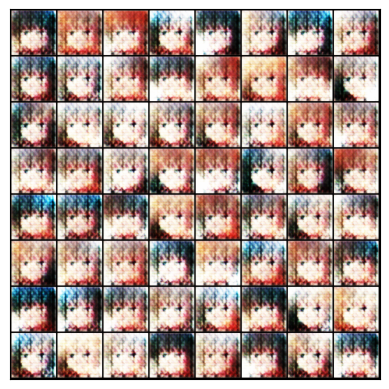

 80%|████████  | 40/50 [01:30<00:20,  2.05s/it]

Epoch 40: |
                      Step: 0 | 
                      D_real Loss: 0.446 | 
                      D_fake Loss: 0.533 | 
                      D_total Loss: 0.979 | 
                      G_Loss: 1.466 |
                      Real_score 0.668 | 
                      Fake_score 0.398 |
                      Fake_score_after_D_update: 0.246
            


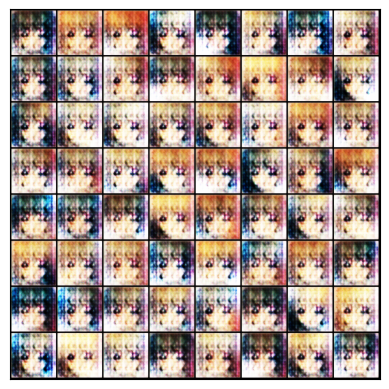

 82%|████████▏ | 41/50 [01:32<00:17,  1.99s/it]

Epoch 41: |
                      Step: 0 | 
                      D_real Loss: 0.382 | 
                      D_fake Loss: 0.386 | 
                      D_total Loss: 0.769 | 
                      G_Loss: 1.896 |
                      Real_score 0.698 | 
                      Fake_score 0.315 |
                      Fake_score_after_D_update: 0.158
            


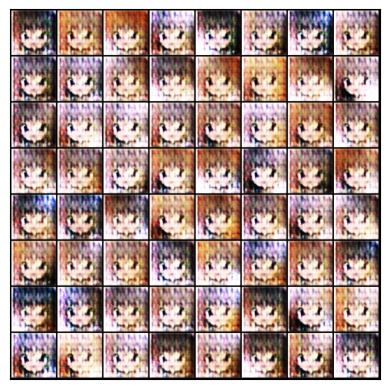

 84%|████████▍ | 42/50 [01:34<00:15,  1.94s/it]

Epoch 42: |
                      Step: 0 | 
                      D_real Loss: 0.228 | 
                      D_fake Loss: 0.705 | 
                      D_total Loss: 0.933 | 
                      G_Loss: 1.885 |
                      Real_score 0.811 | 
                      Fake_score 0.487 |
                      Fake_score_after_D_update: 0.160
            


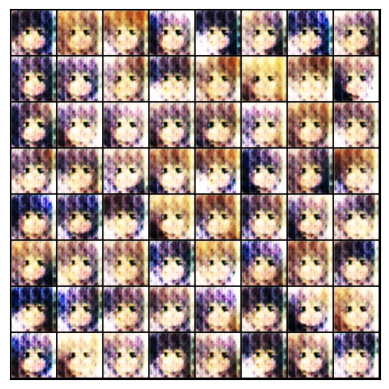

 86%|████████▌ | 43/50 [01:36<00:13,  1.93s/it]

Epoch 43: |
                      Step: 0 | 
                      D_real Loss: 0.662 | 
                      D_fake Loss: 0.314 | 
                      D_total Loss: 0.976 | 
                      G_Loss: 1.556 |
                      Real_score 0.546 | 
                      Fake_score 0.265 |
                      Fake_score_after_D_update: 0.222
            


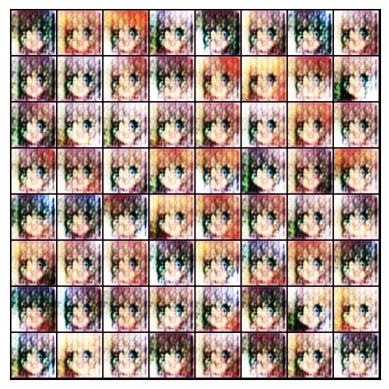

 88%|████████▊ | 44/50 [01:38<00:11,  1.89s/it]

Epoch 44: |
                      Step: 0 | 
                      D_real Loss: 0.617 | 
                      D_fake Loss: 0.365 | 
                      D_total Loss: 0.981 | 
                      G_Loss: 1.537 |
                      Real_score 0.588 | 
                      Fake_score 0.301 |
                      Fake_score_after_D_update: 0.223
            


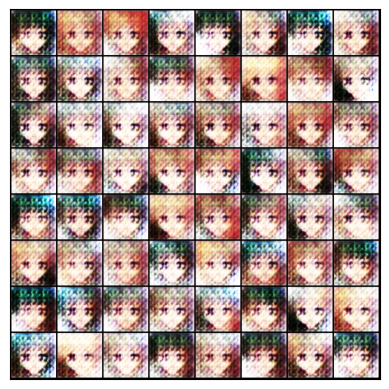

 90%|█████████ | 45/50 [01:40<00:09,  1.94s/it]

Epoch 45: |
                      Step: 0 | 
                      D_real Loss: 0.493 | 
                      D_fake Loss: 0.729 | 
                      D_total Loss: 1.222 | 
                      G_Loss: 2.262 |
                      Real_score 0.642 | 
                      Fake_score 0.494 |
                      Fake_score_after_D_update: 0.112
            


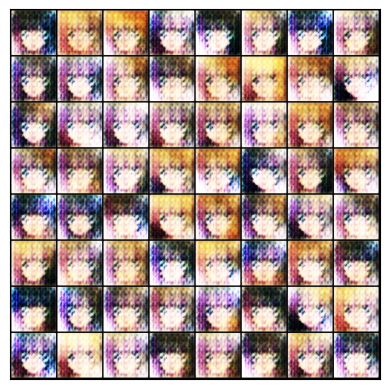

 92%|█████████▏| 46/50 [01:42<00:08,  2.05s/it]

Epoch 46: |
                      Step: 0 | 
                      D_real Loss: 0.404 | 
                      D_fake Loss: 0.555 | 
                      D_total Loss: 0.960 | 
                      G_Loss: 1.866 |
                      Real_score 0.696 | 
                      Fake_score 0.415 |
                      Fake_score_after_D_update: 0.161
            


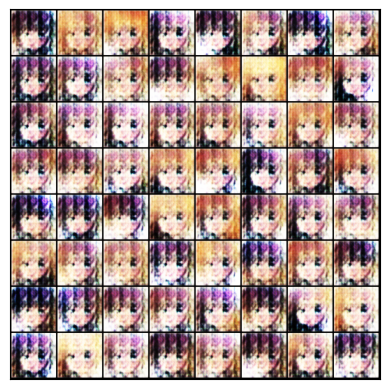

 94%|█████████▍| 47/50 [01:44<00:06,  2.10s/it]

Epoch 47: |
                      Step: 0 | 
                      D_real Loss: 0.364 | 
                      D_fake Loss: 0.480 | 
                      D_total Loss: 0.844 | 
                      G_Loss: 1.698 |
                      Real_score 0.726 | 
                      Fake_score 0.375 |
                      Fake_score_after_D_update: 0.190
            


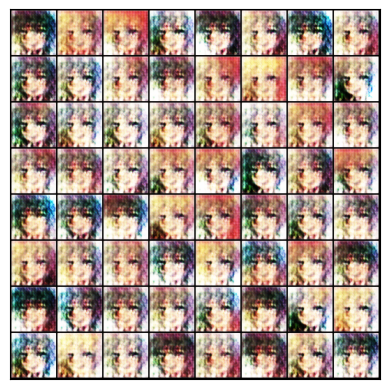

 96%|█████████▌| 48/50 [01:46<00:04,  2.02s/it]

Epoch 48: |
                      Step: 0 | 
                      D_real Loss: 0.455 | 
                      D_fake Loss: 0.479 | 
                      D_total Loss: 0.934 | 
                      G_Loss: 1.608 |
                      Real_score 0.669 | 
                      Fake_score 0.376 |
                      Fake_score_after_D_update: 0.205
            


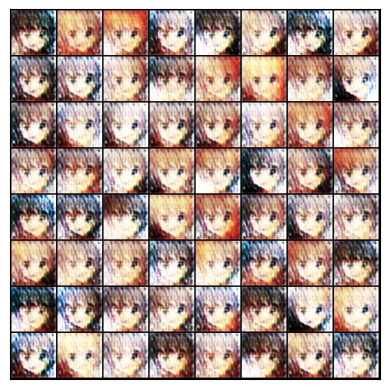

 98%|█████████▊| 49/50 [01:48<00:01,  1.98s/it]

Epoch 49: |
                      Step: 0 | 
                      D_real Loss: 0.373 | 
                      D_fake Loss: 0.406 | 
                      D_total Loss: 0.779 | 
                      G_Loss: 1.743 |
                      Real_score 0.722 | 
                      Fake_score 0.332 |
                      Fake_score_after_D_update: 0.179
            


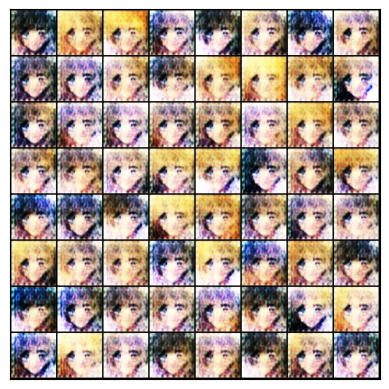

Epoch 49: |
                      Step: 15 | 
                      D_real Loss: 0.449 | 
                      D_fake Loss: 0.374 | 
                      D_total Loss: 0.823 | 
                      G_Loss: 1.970 |
                      Real_score 0.669 | 
                      Fake_score 0.307 |
                      Fake_score_after_D_update: 0.150
            


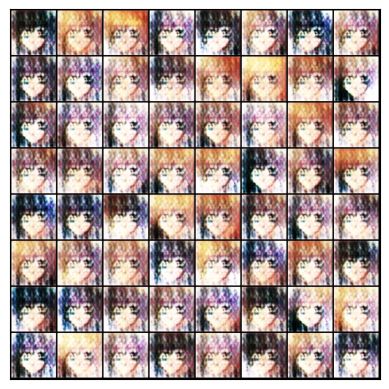

100%|██████████| 50/50 [01:50<00:00,  2.21s/it]


In [ ]:
G_losses = []
D_losses = []

real_score_list = []
fake_score_list = []

iters = 0
num_epochs = 50

fixed_noise = torch.randn(64, nz, 1, 1, device = device)

for epoch in tqdm(range(num_epochs)):
    # For each batch in the dataloader
    for i, data in enumerate(train_dl, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        netD.zero_grad()

        real_images = data[0].to(device)
        real_labels = torch.full((batch_size,), real_label, dtype = torch.float, device = device)

        # Forward pass real batch through D
        output = netD(real_images).view(-1)

        # Discriminator to should classify real images as real
        # Maximize the probability of this
        errD_real = criterion(output, real_labels)

        # Calculate gradients for D in backward pass
        errD_real.backward()

        D_x = output.mean().item()

        # Generate fake image batch with G
        noise = torch.randn(batch_size, nz, 1, 1, device=device)

        fake_images = netG(noise)
        fake_labels = torch.full((batch_size,), fake_label, dtype = torch.float, device = device)

        # Classify all fake batch with D
        output = netD(fake_images.detach()).view(-1)

        # Discriminator to should classify fake images as fake
        # Maximize the probability of this
        errD_fake = criterion(output, fake_labels)

        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()

        D_G_z1 = output.mean().item()

        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake

        optimizerD.step()

        ###########################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################

        netG.zero_grad()

        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake_images).view(-1)

        # Maximize the probability that the discriminator categorizes fake
        # images as real
        errG = criterion(output, real_labels)

        # Calculate gradients for G
        errG.backward()

        D_G_z2 = output.mean().item()

        # Update G
        optimizerG.step()

        if (i % 200 == 0) or ((epoch == num_epochs-1) and (i == len(train_dl) - 1)):
            print(f"""Epoch {epoch+0:01}: |
                      Step: {i} |
                      D_real Loss: {errD_real:.3f} |
                      D_fake Loss: {errD_fake:.3f} |
                      D_total Loss: {errD:.3f} |
                      G_Loss: {errG:.3f} |
                      Real_score {D_x:.3f} |
                      Fake_score {D_G_z1:.3f} |
                      Fake_score_after_D_update: {D_G_z2:.3f}
            """)

            # View the output of the GAN every so often
            with torch.no_grad():
                fake_images = netG(fixed_noise).reshape(batch_size, 3, 64, 64).detach().cpu()
                display_image_grid(epoch, i, fake_images, nrow = 8)

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        real_score_list.append(D_x)
        fake_score_list.append(D_G_z1)

 First, we will see how D and G’s losses changed during training.Discriminator loss is increasing and Generator loss is decreasing Real score and Fake score should converge ideally to 0.5

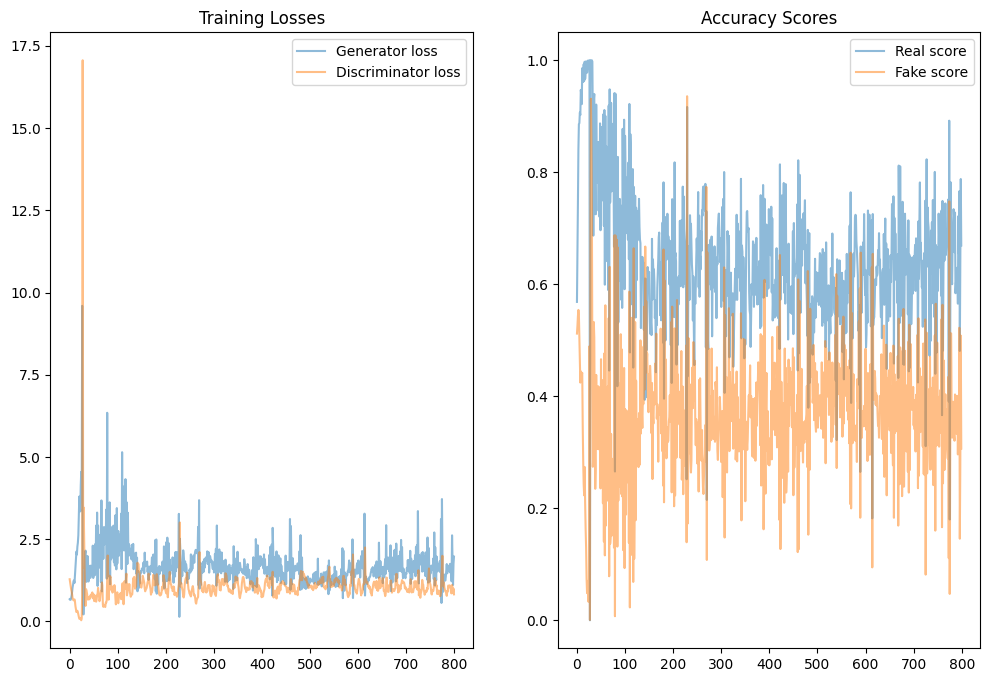

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (12, 8))

ax1.plot(G_losses, label = 'Generator loss', alpha = 0.5)
ax1.plot(D_losses, label = 'Discriminator loss', alpha = 0.5)
ax1.legend()

ax1.set_title('Training Losses')
ax2.plot(real_score_list, label = 'Real score', alpha = 0.5)
ax2.plot(fake_score_list, label = 'Fake score', alpha = 0.5)
ax2.set_title('Accuracy Scores')

ax2.legend()